[![Roboflow Notebooks](https://ik.imagekit.io/roboflow/notebooks/template/bannertest2-2.png?ik-sdk-version=javascript-1.4.3&updatedAt=1672932710194)](https://github.com/roboflow/notebooks)

# Zero-Shot Object Detection with Grounding DINO

---

[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/zero-shot-object-detection-with-grounding-dino.ipynb) [![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/IDEA-Research/GroundingDINO) [![arXiv](https://img.shields.io/badge/arXiv-2303.05499-b31b1b.svg)](https://arxiv.org/abs/2303.05499)

Grounding DINO can detect **arbitrary objects** with human inputs such as category names or referring expressions. The key solution of open-set object detection is introducing language to a closed-set detector DINO. for open-set concept generalization. If you want to learn more visit official GitHub [repository](https://github.com/IDEA-Research/GroundingDINO) and read the [paper](https://arxiv.org/abs/2303.05499).

![grounding dino figure](https://media.roboflow.com/notebooks/examples/grounding-dino-figure.png)

## Complementary Materials

---

[![Roboflow](https://raw.githubusercontent.com/roboflow-ai/notebooks/main/assets/badges/roboflow-blogpost.svg)](https://blog.roboflow.com/grounding-dino-zero-shot-object-detection) [![YouTube](https://badges.aleen42.com/src/youtube.svg)](https://youtu.be/cMa77r3YrDk)

We recommend that you follow along in this notebook while reading the blog post on Grounding DINO. We will talk about the advantages of Grounding DINO, analyze the model architecture, and provide real prompt examples.

![grounding dino](https://media.roboflow.com/notebooks/examples/grounding-dino.png)

## ⚠️ Disclaimer

Grounding DINO codebase is still under development. If you experience any problems with launching the notebook, please let us know and create [issues](https://github.com/roboflow/notebooks/issues) on our GitHub.

## Pro Tip: Use GPU Acceleration

If you are running this notebook in Google Colab, navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`. This will ensure your notebook uses a GPU, which will significantly speed up model training times.

## Steps in this Tutorial

In this tutorial, we are going to cover:

- Before you start
- Install Grounding DINO 🦕
- Download Grounding DINO Weights 🏋️
- Download Example Data
- Load Grounding DINO Model
- Grounding DINO Demo
- Grounding DINO with Roboflow Dataset
- 🏆 Congratulations

**Let's begin!**

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [1]:
!nvidia-smi

Mon Jul 24 12:34:11 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   59C    P8    13W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Imports

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [21]:
import cv2
from copy import deepcopy

## Install Grounding DINO 🦕

In [4]:
%cd {HOME}
!git clone https://github.com/IDEA-Research/GroundingDINO.git
%cd {HOME}/GroundingDINO
!pip install -q -e .
!pip install -q roboflow

/content
Cloning into 'GroundingDINO'...
remote: Enumerating objects: 401, done.
remote: Counting objects: 100% (77/77), done.
remote: Compressing objects: 100% (33/33), done.
remote: Total 401 (delta 52), reused 44 (delta 44), pack-reused 324
Receiving objects: 100% (401/401), 12.84 MiB | 23.53 MiB/s, done.
Resolving deltas: 100% (205/205), done.
/content/GroundingDINO
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 36.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.3/250.3 kB 25.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 57.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 26.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 44.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 51.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━

In [5]:
import os

CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
print(CONFIG_PATH, "; exist:", os.path.isfile(CONFIG_PATH))

/content/GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py ; exist: True


## Download Grounding DINO Weights 🏋️

In [6]:
%cd {HOME}
!mkdir {HOME}/weights
%cd {HOME}/weights

!wget -q https://github.com/IDEA-Research/GroundingDINO/releases/download/v0.1.0-alpha/groundingdino_swint_ogc.pth

/content
/content/weights


In [7]:
import os

WEIGHTS_NAME = "groundingdino_swint_ogc.pth"
WEIGHTS_PATH = os.path.join(HOME, "weights", WEIGHTS_NAME)
print(WEIGHTS_PATH, "; exist:", os.path.isfile(WEIGHTS_PATH))

/content/weights/groundingdino_swint_ogc.pth ; exist: True


## Insert Data

In [8]:
%cd {HOME}
!mkdir {HOME}/data

/content


Action required: copy annotations in COCO format to the data folder  
Action required: insert all the photos (plain structure) to the data folder

These are coordinates that determine an object's location. These coordinates are represented as [xmin, ymin, width, height] where the (xmin, ymin) coordinates correspond to the top-left position of an object. The width and height are xmax - xmin and ymax - ymin respectively.

## Process annotations

In [9]:
import json
import pandas as pd

with open("/content/data/coco_annotations_all.json", 'r') as f:
    data = json.load(f)

images_df = pd.DataFrame(data['images']).drop(['license', 'flickr_url',
                                               'coco_url', 'date_captured'],
                                              axis=1)
images_df.rename(columns={'id': 'image_id', 'bbox': 'bbox_coco'}, inplace=True)

cat_id2name = {d['id']: d['name'] for d in data['categories']}

annot_df = pd.DataFrame(data['annotations']).drop(['iscrowd', 'attributes'], axis=1)
print(annot_df.shape)
annot_df = pd.merge(annot_df, images_df, on='image_id')
print(annot_df.shape)
annot_df['category_name'] = annot_df['category_id'].map(cat_id2name)
annot_df['pt1'] = annot_df['bbox'].apply(lambda bbox: tuple([int(bbox[0]), int(bbox[1])]))
annot_df['pt2'] = annot_df['bbox'].apply(lambda bbox: tuple([int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3])]))
annot_df.head(3)

(49, 6)
(49, 9)


,id,image_id,category_id,segmentation,area,bbox,width,height,file_name,category_name,pt1,pt2
0,1,1,1,"{'counts': [289136, 3, 1276, 5, 1274, 7, 1271,...",398545.0,"[225.0, 93.0, 580.0, 1158.0]",960,1280,2023-04-19 23.11.11.jpg,barbie,"(225, 93)","(805, 1251)"
1,2,2,1,"{'counts': [92156, 4, 1274, 6, 1272, 8, 1271, ...",760002.0,"[71.0, 0.0, 887.0, 1280.0]",960,1280,2023-04-19 23.11.27.jpg,barbie,"(71, 0)","(958, 1280)"
2,3,3,1,"{'counts': [343923, 19, 1258, 28, 1249, 33, 12...",382491.0,"[268.0, 42.0, 668.0, 1104.0]",960,1280,2023-04-19 23.11.31.jpg,barbie,"(268, 42)","(936, 1146)"


In [10]:
pd.DataFrame(annot_df.bbox.tolist(), index=annot_df.index).describe()

,0,1,2,3
count,49.000000,49.000000,49.000000,49.000000
mean,339.040816,202.020408,386.020408,795.877551
std,244.514481,203.497184,206.144517,333.872520
min,0.000000,0.000000,108.000000,162.000000
25%,162.000000,66.000000,233.000000,516.000000
50%,268.000000,106.000000,315.000000,728.000000
75%,505.000000,289.000000,504.000000,1131.000000
max,1026.000000,836.000000,887.000000,1280.000000


The COCO bounding box format is [top left x position, top left y position, width, height]. The category id corresponds to a single category specified in the categories section. Each annotation also has an id (unique to all other annotations in the dataset)

## Load Grounding DINO Model

In [11]:
%cd {HOME}/GroundingDINO

# https://github.com/IDEA-Research/GroundingDINO/blob/main/groundingdino/util/inference.py
from groundingdino.util.inference import load_model, load_image, predict, annotate

model = load_model(CONFIG_PATH, WEIGHTS_PATH)

/content/GroundingDINO


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


final text_encoder_type: bert-base-uncased


## Grounding DINO inference example

In [12]:
import os
import supervision as sv
import torch

In [46]:
import logging
logging.disable(logging.WARNING)

/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


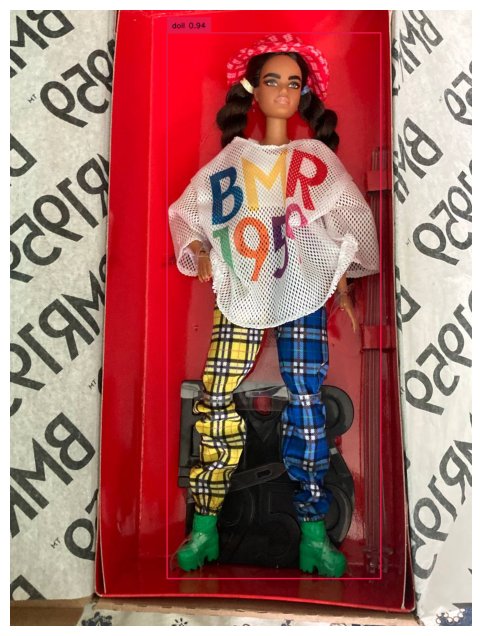

In [58]:
IMAGE_NAME = annot_df['file_name'][3]
IMAGE_PATH = os.path.join(HOME, 'data', IMAGE_NAME)

TEXT_PROMPT = "doll"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

# ‘cxcywh’ : boxes are represented via centre, width and height, cx, cy being center of box, w, h being width and height.
predicted_boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=predicted_boxes,
                           logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (8, 8))

## Evaluation example

In [23]:
image_source.shape

(1280, 960, 3)

In [57]:
# box_convert(boxes=annot_df[annot_df['file_name'] == IMAGE_NAME]['bbox'].values[0], in_fmt="xywh", out_fmt="xyxy")

In [59]:
# mimics "annotate" function

def convert_pred_boxes_to_xyxy(predicted_boxes, image_source):
    from torchvision.ops import box_convert
    h, w, _ = image_source.shape
    predicted_boxes = predicted_boxes * torch.Tensor([w, h, w, h])
    pred_xyxy = box_convert(boxes=predicted_boxes, in_fmt="cxcywh", out_fmt="xyxy").to(torch.int32).numpy()
    # detections = sv.Detections(xyxy=pred_xyxy)
    return pred_xyxy

In [60]:
predicted_boxes_xyxy_list = convert_pred_boxes_to_xyxy(predicted_boxes=predicted_boxes, image_source=image_source)
predicted_boxes_xyxy_list

array([[ 326,   47,  770, 1181]], dtype=int32)

predicted_box [ 326   47  770 1181]


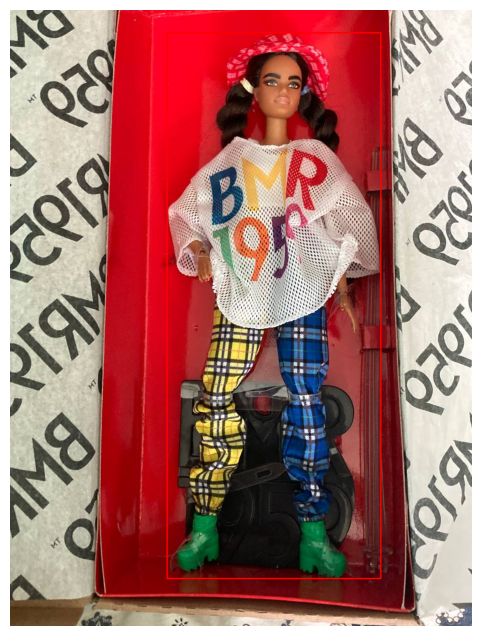

In [61]:
def plot_bb(bb_xyxy_list, img, color=(0, 0, 0), plot=True):
    img = deepcopy(img)
    for predicted_box in bb_xyxy_list:
        print('predicted_box', predicted_box)
        img = cv2.rectangle(img=img,
                            pt1=predicted_box[:2],
                            pt2=predicted_box[2:],
                            color=color,
                            thickness=2
                            )
    if plot:
        img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
        sv.plot_image(img, (8, 8))
    return img

plot_bb(bb_xyxy_list=predicted_boxes_xyxy_list, img=image_source, color=(255, 0, 0));

predicted_box (330, 50, 767, 1181)


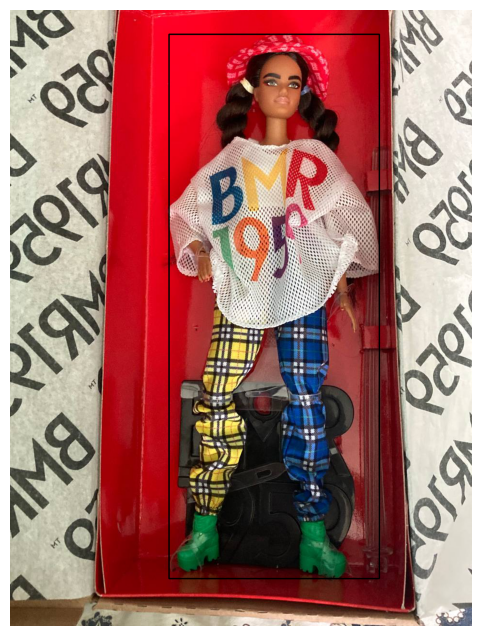

In [62]:
gt_bbox_list = [annot_df[annot_df['file_name'] == IMAGE_NAME].apply(lambda x: x['pt1'] + x['pt2'], axis=1).values[0]]
plot_bb(bb_xyxy_list=gt_bbox_list, img=image_source, color=(0, 0, 0));

In [63]:
def intersection_over_union(gt_box, pred_box):
    inter_box_top_left = [max(gt_box[0], pred_box[0]),
                          max(gt_box[1], pred_box[1])]
    inter_box_bottom_right = [min(gt_box[0]+gt_box[2], pred_box[0]+pred_box[2]),
                              min(gt_box[1]+gt_box[3], pred_box[1]+pred_box[3])]

    inter_box_w = inter_box_bottom_right[0] - inter_box_top_left[0]
    inter_box_h = inter_box_bottom_right[1] - inter_box_top_left[1]

    intersection = inter_box_w * inter_box_h
    union = gt_box[2] * gt_box[3] + pred_box[2] * pred_box[3] - intersection

    iou = intersection / union

    return iou, intersection, union

In [65]:
for predicted_box in predicted_boxes_xyxy_list:
    res = intersection_over_union(
        gt_box=gt_bbox_list[0],
        pred_box=predicted_box)
    print(res)

(0.9884964545067146, 902348, 912849)


In [66]:
intersection_over_union(
        gt_box=gt_bbox_list[0],
        pred_box=gt_bbox_list[0])

(1.0, 905827, 905827)

In [51]:
intersection_over_union(
        gt_box=annot_df[annot_df['file_name'] == IMAGE_NAME]['bbox'].values[0],
        pred_box=annot_df[annot_df['file_name'] == IMAGE_NAME]['bbox'].values[0])

(1.0, 494247.0, 494247.0)

In [52]:
intersection_over_union(
        gt_box=predicted_box,
        pred_box=predicted_box)

(1.0, 1221132, 1221132)

## Eval all

2023-04-19 23.11.11.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 142   90  808 1276]
predicted_box (225, 93, 805, 1251)


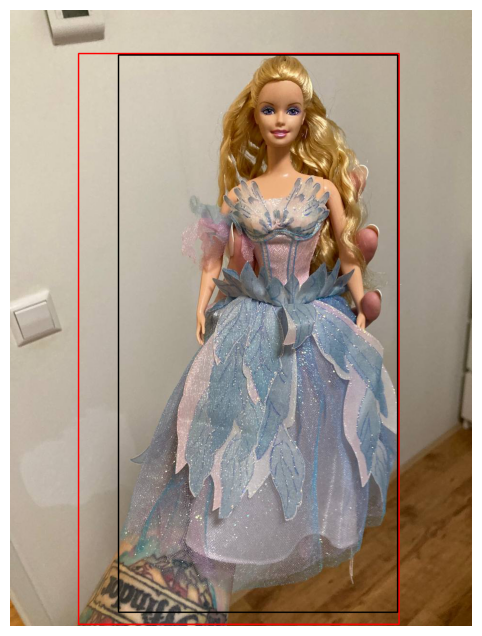

(0.8018606863480118, 906975, 1131088)
2023-04-19 23.11.27.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  64    0  956 1277]
predicted_box (71, 0, 958, 1280)


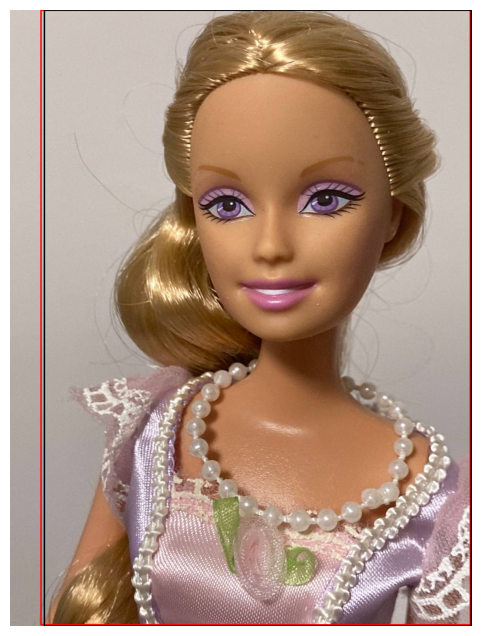

(0.9811314797288491, 1211873, 1235179)
2023-04-19 23.11.31.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 263   38  945 1277]
predicted_box (268, 42, 936, 1146)


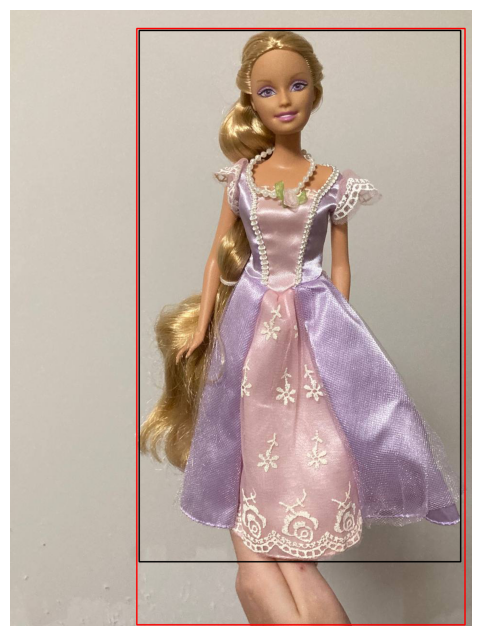

(0.888869001006824, 1072656, 1206765)
2023-04-19 23.11.33.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 326   47  770 1181]
predicted_box (330, 50, 767, 1181)


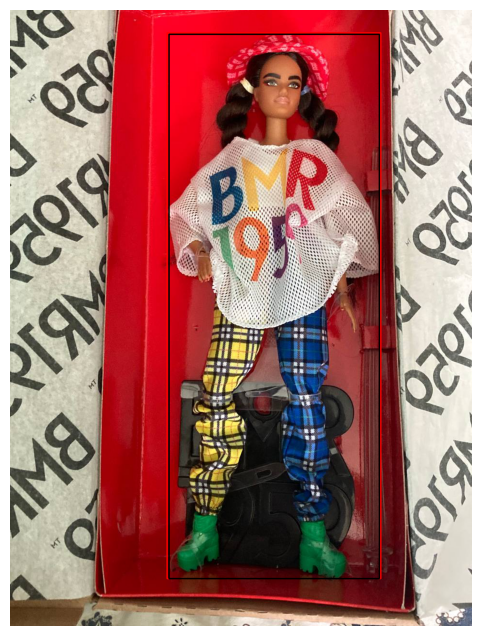

(0.9884964545067146, 902348, 912849)
2023-04-19 23.11.37.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 110   20  815 1273]
predicted_box [ 228   20  815 1246]
predicted_box (239, 22, 811, 1242)


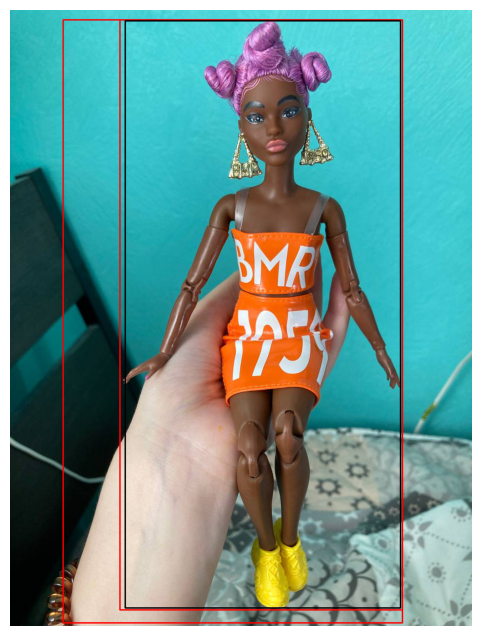

(0.7143287123400224, 852012, 1192745)
(0.9749888691875679, 998568, 1024184)
2023-04-19 23.11.38.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 239    5 1022  927]
predicted_box (245, 9, 1022, 922)


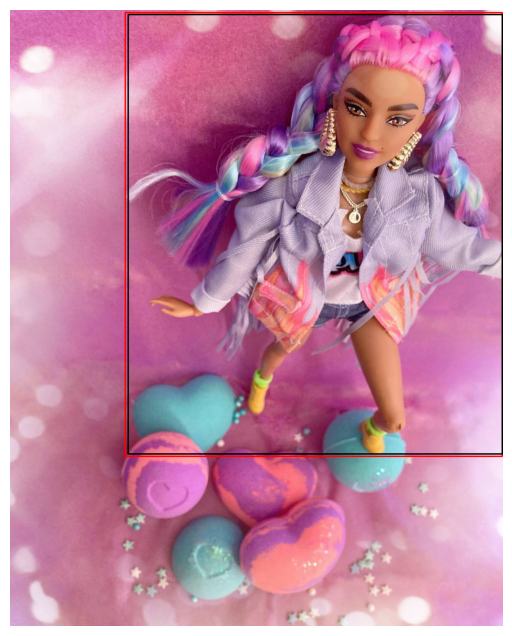

(0.9830270136400938, 936752, 952926)
2023-04-19 23.11.40.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  17   16  676 1176]
predicted_box (22, 18, 718, 1172)


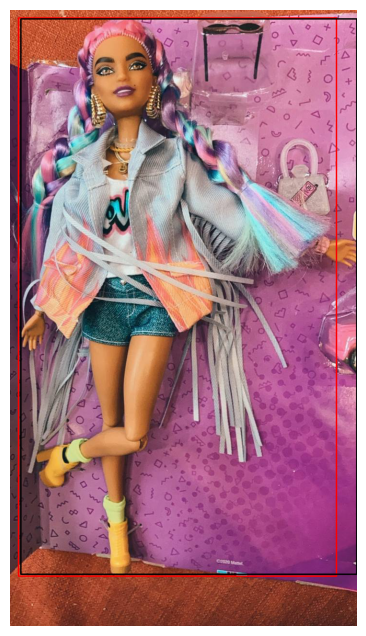

(0.9251252852739806, 786412, 850060)
2023-04-19 23.11.41.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 207   62  759 1198]
predicted_box (215, 66, 741, 1197)


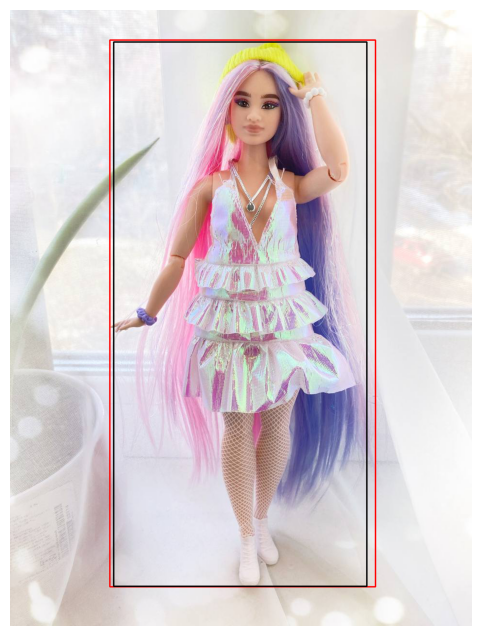

(0.9706518340546678, 884754, 911505)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


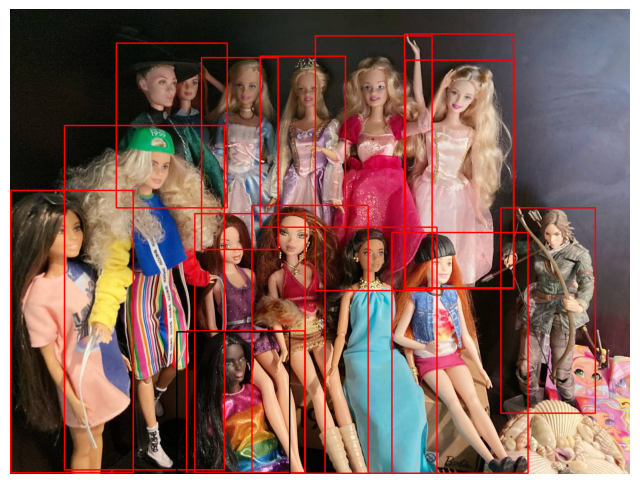

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


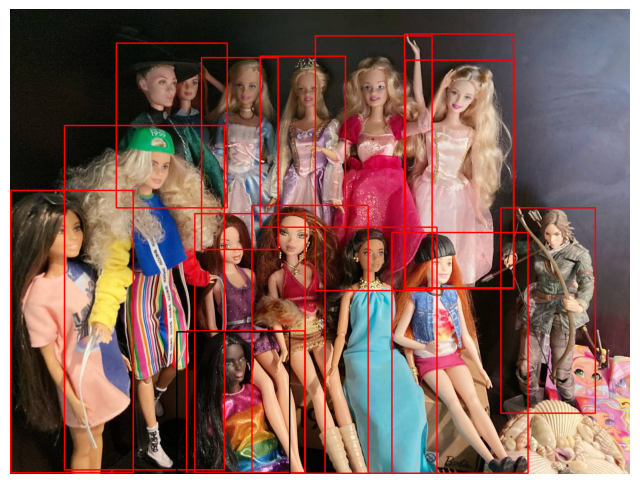

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


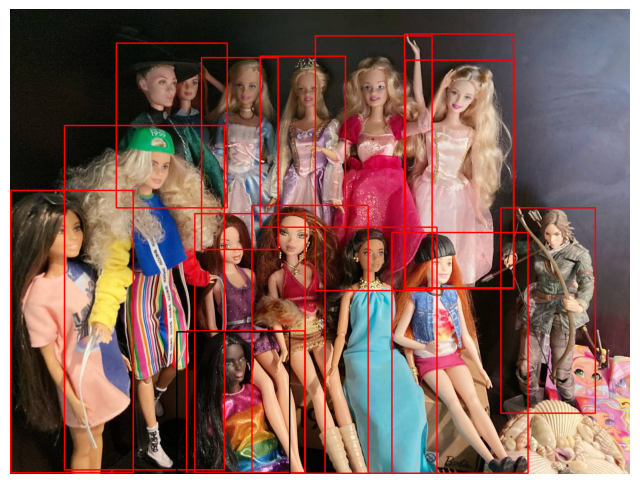

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


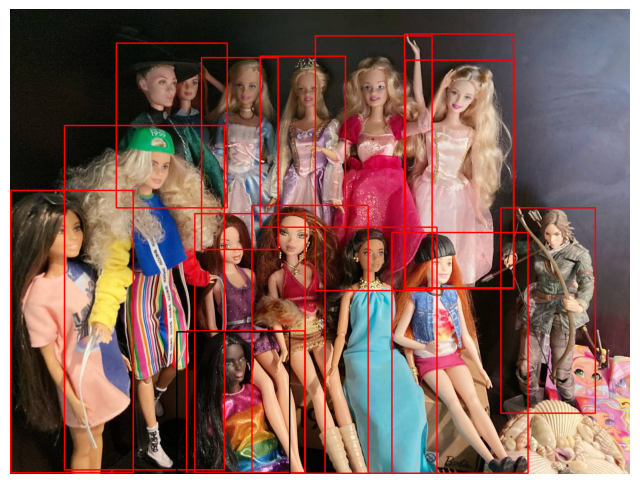

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


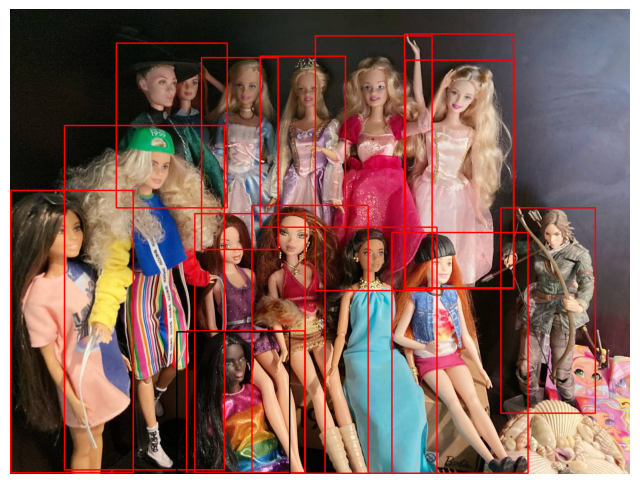

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


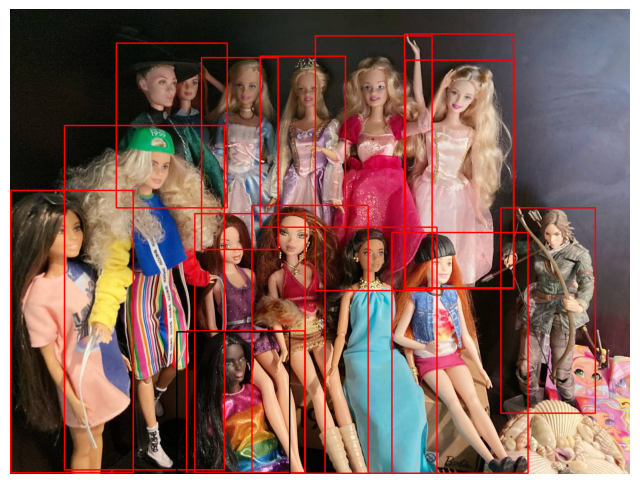

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


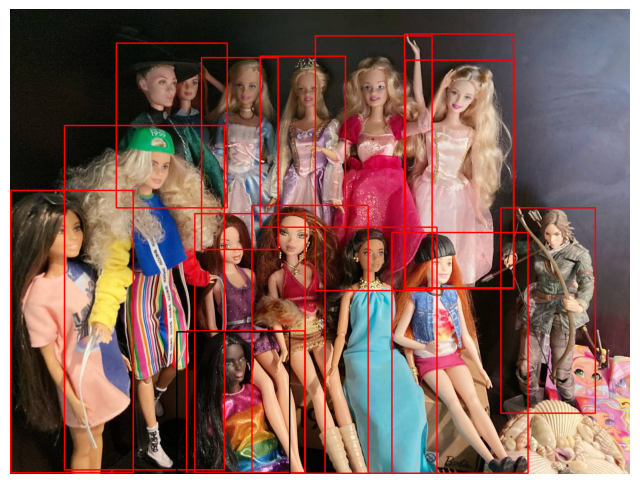

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


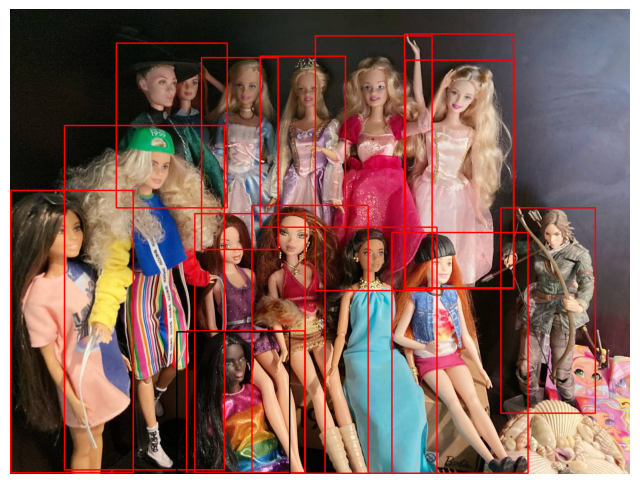

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


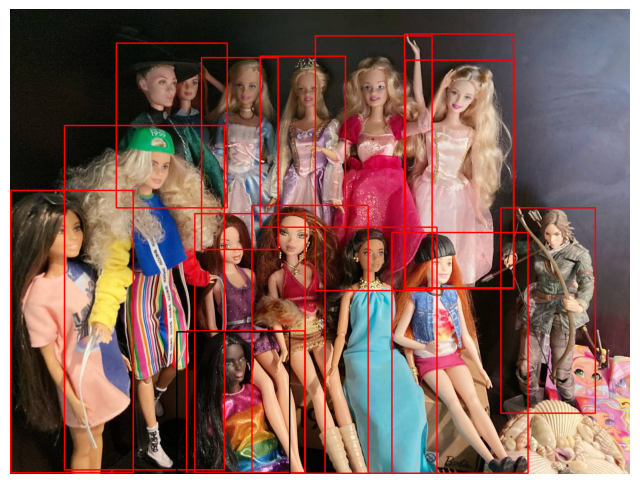

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


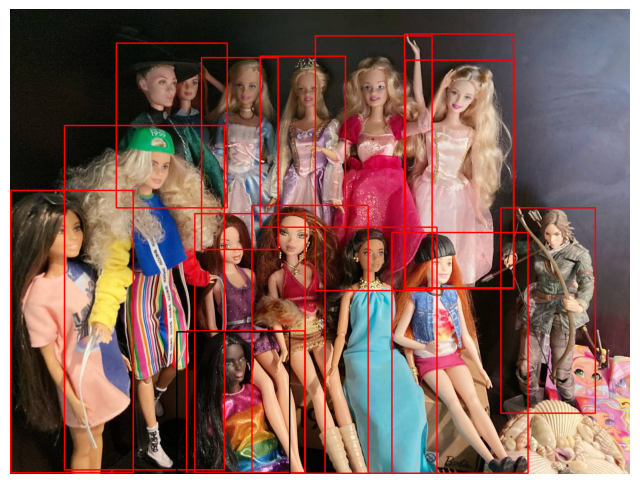

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


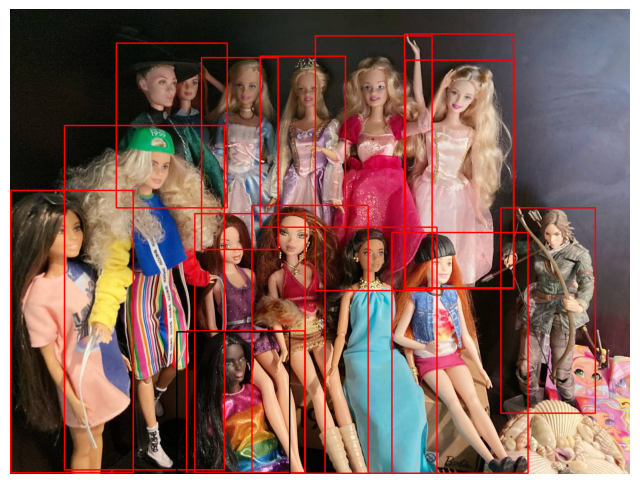

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


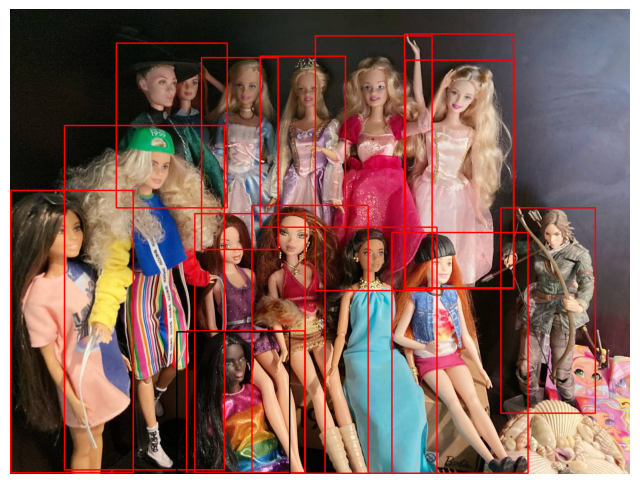

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.43.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 788  461 1069  958]
predicted_box [630  55 871 581]
predicted_box [650 450 881 958]
predicted_box [  1 374 254 957]
predicted_box [ 816  105 1040  575]
predicted_box [112 240 442 951]
predicted_box [499 405 739 958]
predicted_box [395 100 553 496]
predicted_box [1013  410 1208  834]
predicted_box [381 422 609 957]
predicted_box [364 664 608 958]
predicted_box [219  70 448 410]
predicted_box [516  97 692 450]
predicted_box [ 814   51 1039  577]
predicted_box (344, 666, 577, 959)


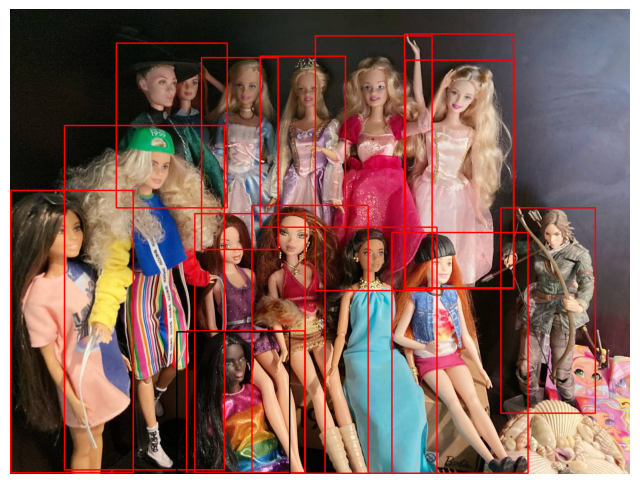

(0.06779210124443578, 100149, 1477296)
(-0.00817320835408623, -8730, 1068124)
(0.1680923612695913, 201082, 1196259)
(-0.06917319420387422, -59185, 855606)
(0.0012784020496176534, 1470, 1149873)
(0.1276876661242595, 110250, 863435)
(0.3041178860821923, 294134, 967171)
(-0.04259350732430178, -36820, 864451)
(-0.032946899951734554, -53176, 1613991)
(0.5125836066970562, 385020, 751136)
(0.8826102450626953, 532492, 603315)
(-0.07537062429980643, -60078, 797101)
(-0.05279109862882255, -48195, 912938)
(-0.003514528330590399, -4066, 1156912)
2023-04-19 23.11.46.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 231   16  817 1277]
predicted_box (236, 17, 808, 1280)


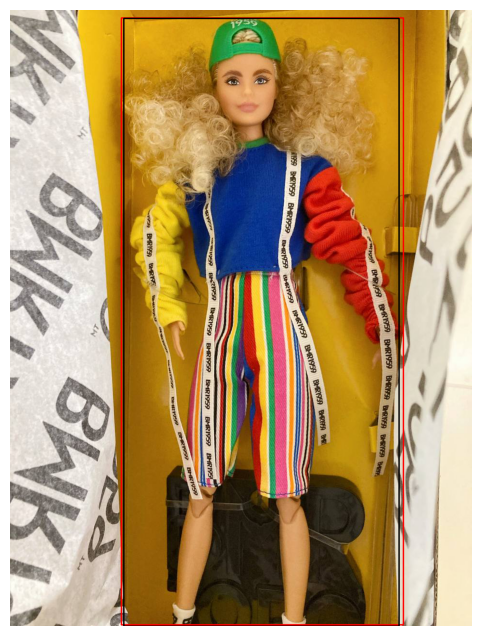

(0.9851577721274178, 1031008, 1046541)
2023-04-19 23.11.47.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 153   54  956 1277]
predicted_box (162, 57, 957, 1280)


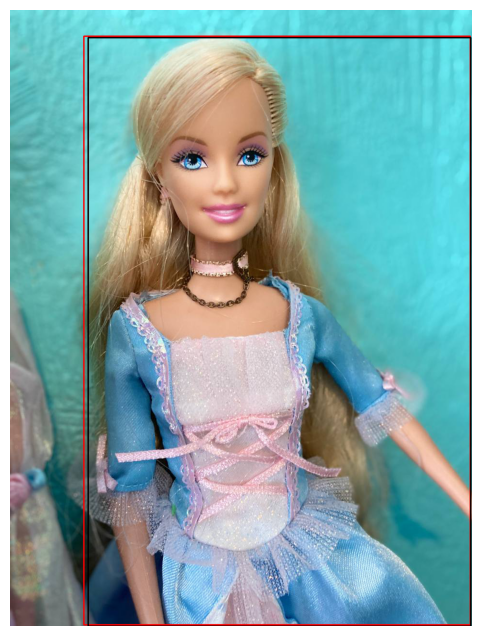

(0.9735204075869003, 1206478, 1239294)
2023-04-19 23.11.51.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  88  102  957 1276]
predicted_box (111, 109, 958, 1280)


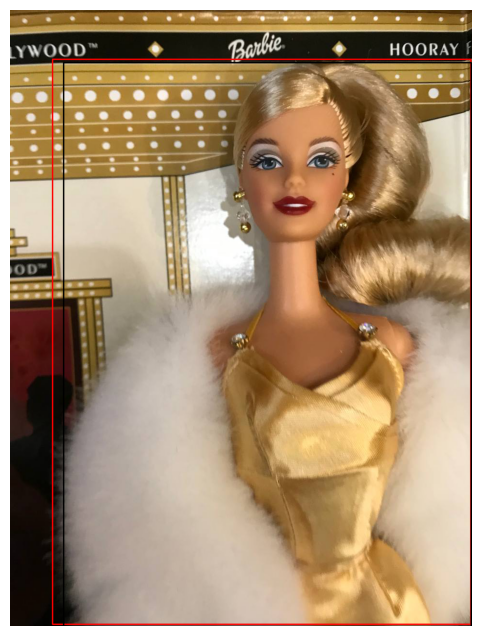

(0.9390869057447513, 1185246, 1262126)
2023-04-19 23.11.52.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 120  128  820 1150]
predicted_box (124, 133, 816, 1144)


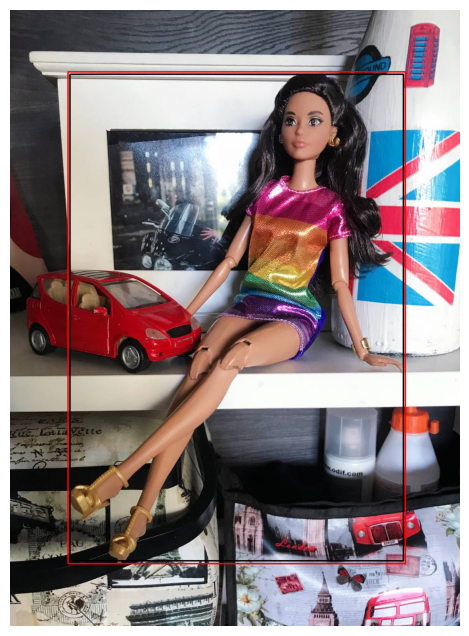

(0.9899300106044538, 933504, 943000)
2023-04-19 23.11.54.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 240   29  852 1277]
predicted_box [ 822  283  958 1277]
predicted_box [   0  614  306 1278]
predicted_box (247, 34, 839, 1280)


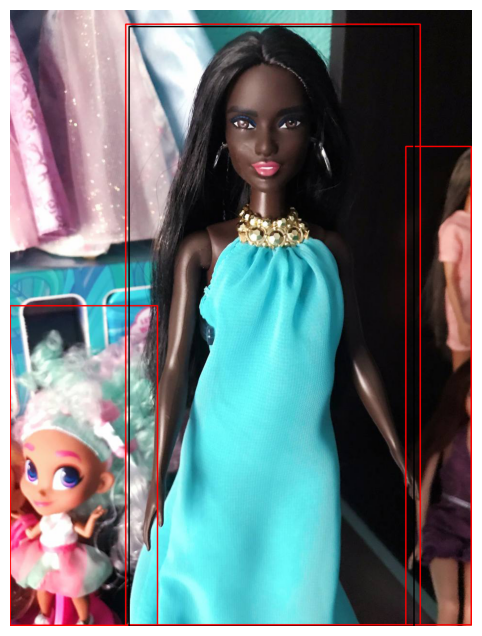

(0.9748720216019497, 1067208, 1094716)
(0.134405081818101, 272184, 2025102)
(0.02900916492939464, 41300, 1423688)
2023-04-19 23.16.20.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  20  419  338 1149]
predicted_box [ 228  395  490 1067]
predicted_box [757 249 914 660]
predicted_box [491 582 758 992]
predicted_box [332 337 533 913]
predicted_box [639 285 822 804]
predicted_box [549 255 709 749]
predicted_box [438 259 634 645]
predicted_box (235, 398, 492, 1121)


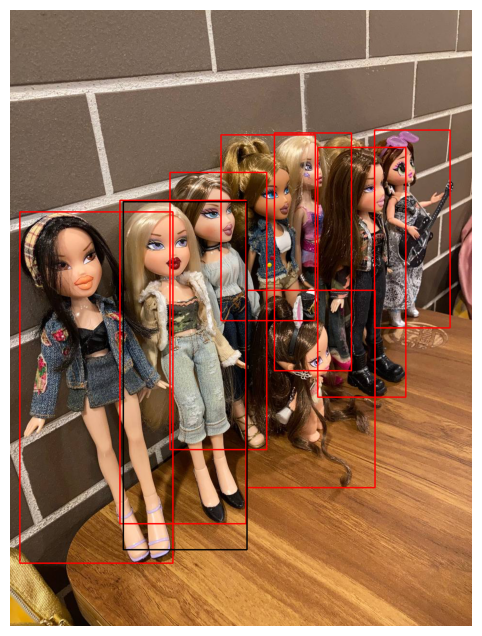

(0.16815934496155824, 135300, 804594)
(0.9169631546079043, 513912, 560450)
(-0.013101421927319157, -15330, 1170102)
(0.20430993702510125, 221132, 1082336)
(0.47966067150213576, 336540, 701621)
(0.052802506399724905, 60808, 1151612)
(0.11066733011526564, 107868, 974705)
(0.17959834346153658, 146234, 814228)
2023-04-19 23.16.20.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  20  419  338 1149]
predicted_box [ 228  395  490 1067]
predicted_box [757 249 914 660]
predicted_box [491 582 758 992]
predicted_box [332 337 533 913]
predicted_box [639 285 822 804]
predicted_box [549 255 709 749]
predicted_box [438 259 634 645]
predicted_box (235, 398, 492, 1121)


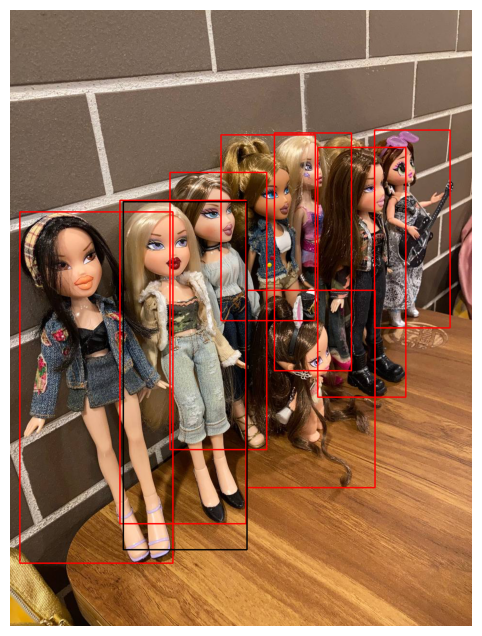

(0.16815934496155824, 135300, 804594)
(0.9169631546079043, 513912, 560450)
(-0.013101421927319157, -15330, 1170102)
(0.20430993702510125, 221132, 1082336)
(0.47966067150213576, 336540, 701621)
(0.052802506399724905, 60808, 1151612)
(0.11066733011526564, 107868, 974705)
(0.17959834346153658, 146234, 814228)
2023-04-19 23.16.20.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  20  419  338 1149]
predicted_box [ 228  395  490 1067]
predicted_box [757 249 914 660]
predicted_box [491 582 758 992]
predicted_box [332 337 533 913]
predicted_box [639 285 822 804]
predicted_box [549 255 709 749]
predicted_box [438 259 634 645]
predicted_box (235, 398, 492, 1121)


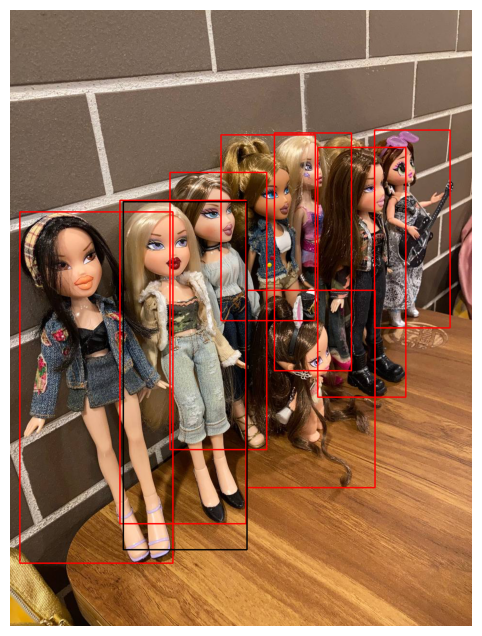

(0.16815934496155824, 135300, 804594)
(0.9169631546079043, 513912, 560450)
(-0.013101421927319157, -15330, 1170102)
(0.20430993702510125, 221132, 1082336)
(0.47966067150213576, 336540, 701621)
(0.052802506399724905, 60808, 1151612)
(0.11066733011526564, 107868, 974705)
(0.17959834346153658, 146234, 814228)
2023-04-19 23.16.20.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  20  419  338 1149]
predicted_box [ 228  395  490 1067]
predicted_box [757 249 914 660]
predicted_box [491 582 758 992]
predicted_box [332 337 533 913]
predicted_box [639 285 822 804]
predicted_box [549 255 709 749]
predicted_box [438 259 634 645]
predicted_box (235, 398, 492, 1121)


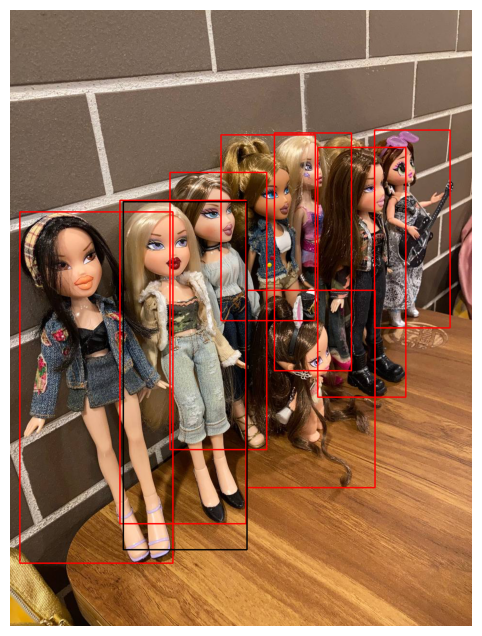

(0.16815934496155824, 135300, 804594)
(0.9169631546079043, 513912, 560450)
(-0.013101421927319157, -15330, 1170102)
(0.20430993702510125, 221132, 1082336)
(0.47966067150213576, 336540, 701621)
(0.052802506399724905, 60808, 1151612)
(0.11066733011526564, 107868, 974705)
(0.17959834346153658, 146234, 814228)
2023-04-19 23.16.20.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  20  419  338 1149]
predicted_box [ 228  395  490 1067]
predicted_box [757 249 914 660]
predicted_box [491 582 758 992]
predicted_box [332 337 533 913]
predicted_box [639 285 822 804]
predicted_box [549 255 709 749]
predicted_box [438 259 634 645]
predicted_box (235, 398, 492, 1121)


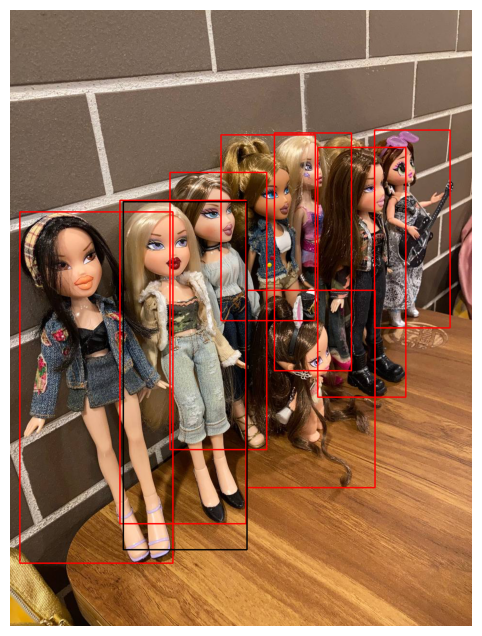

(0.16815934496155824, 135300, 804594)
(0.9169631546079043, 513912, 560450)
(-0.013101421927319157, -15330, 1170102)
(0.20430993702510125, 221132, 1082336)
(0.47966067150213576, 336540, 701621)
(0.052802506399724905, 60808, 1151612)
(0.11066733011526564, 107868, 974705)
(0.17959834346153658, 146234, 814228)
2023-04-19 23.16.20.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  20  419  338 1149]
predicted_box [ 228  395  490 1067]
predicted_box [757 249 914 660]
predicted_box [491 582 758 992]
predicted_box [332 337 533 913]
predicted_box [639 285 822 804]
predicted_box [549 255 709 749]
predicted_box [438 259 634 645]
predicted_box (235, 398, 492, 1121)


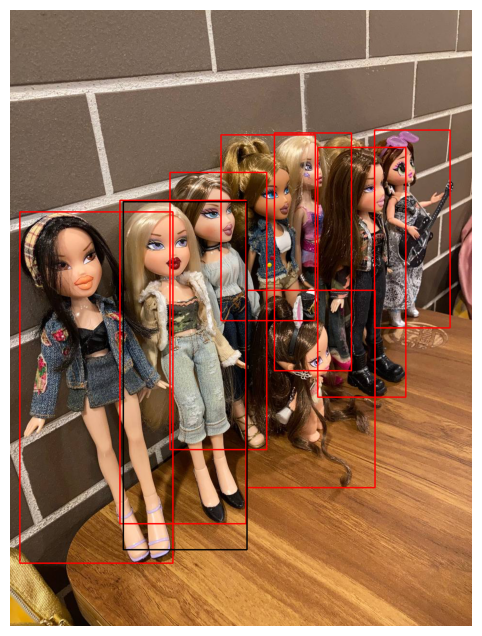

(0.16815934496155824, 135300, 804594)
(0.9169631546079043, 513912, 560450)
(-0.013101421927319157, -15330, 1170102)
(0.20430993702510125, 221132, 1082336)
(0.47966067150213576, 336540, 701621)
(0.052802506399724905, 60808, 1151612)
(0.11066733011526564, 107868, 974705)
(0.17959834346153658, 146234, 814228)
2023-04-19 23.16.20.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  20  419  338 1149]
predicted_box [ 228  395  490 1067]
predicted_box [757 249 914 660]
predicted_box [491 582 758 992]
predicted_box [332 337 533 913]
predicted_box [639 285 822 804]
predicted_box [549 255 709 749]
predicted_box [438 259 634 645]
predicted_box (235, 398, 492, 1121)


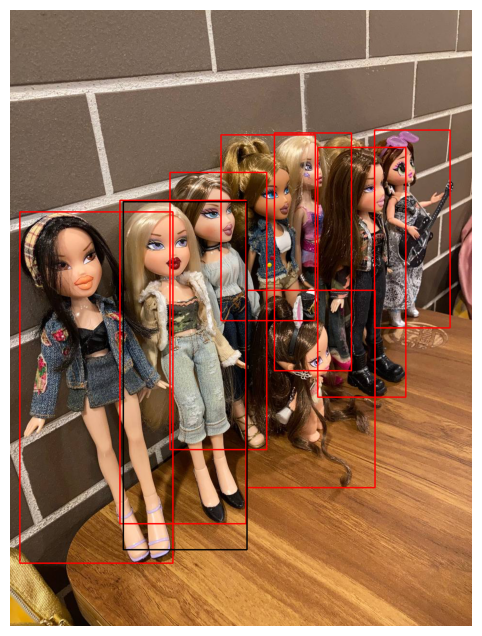

(0.16815934496155824, 135300, 804594)
(0.9169631546079043, 513912, 560450)
(-0.013101421927319157, -15330, 1170102)
(0.20430993702510125, 221132, 1082336)
(0.47966067150213576, 336540, 701621)
(0.052802506399724905, 60808, 1151612)
(0.11066733011526564, 107868, 974705)
(0.17959834346153658, 146234, 814228)
2023-04-19 23.16.20.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  20  419  338 1149]
predicted_box [ 228  395  490 1067]
predicted_box [757 249 914 660]
predicted_box [491 582 758 992]
predicted_box [332 337 533 913]
predicted_box [639 285 822 804]
predicted_box [549 255 709 749]
predicted_box [438 259 634 645]
predicted_box (235, 398, 492, 1121)


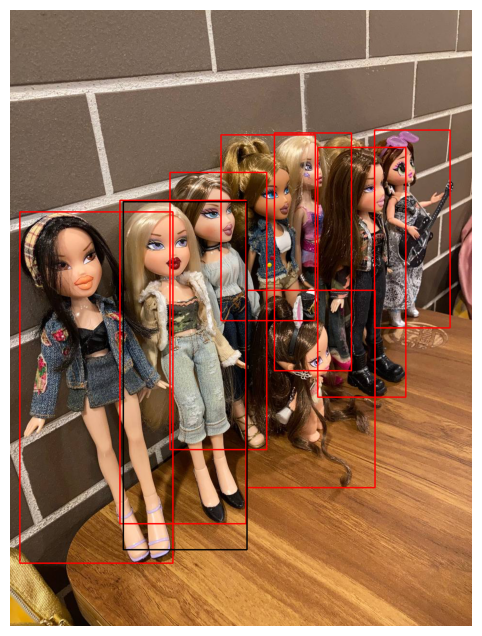

(0.16815934496155824, 135300, 804594)
(0.9169631546079043, 513912, 560450)
(-0.013101421927319157, -15330, 1170102)
(0.20430993702510125, 221132, 1082336)
(0.47966067150213576, 336540, 701621)
(0.052802506399724905, 60808, 1151612)
(0.11066733011526564, 107868, 974705)
(0.17959834346153658, 146234, 814228)
2023-04-19 23.16.34.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  48  725  549 1278]
predicted_box [ 84 130 422 866]
predicted_box [214  68 619 978]
predicted_box [ 587  829  958 1275]
predicted_box [ 508  146  957 1156]
predicted_box [   0  153  137 1000]
predicted_box (513, 152, 958, 1152)


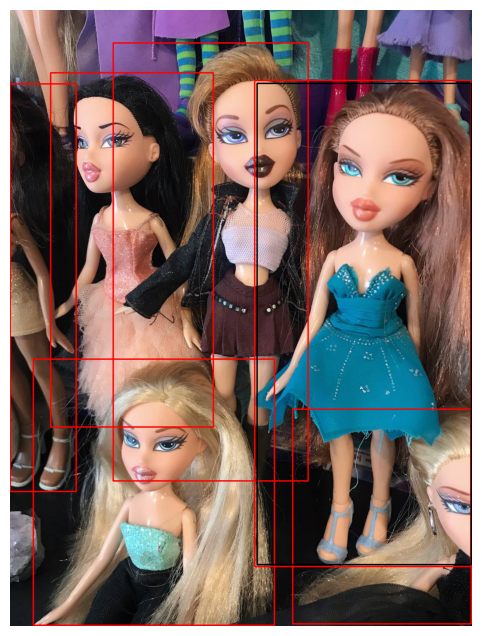

(0.02768754675219543, 48636, 1756602)
(-0.004005488902870284, -5908, 1474976)
(0.20105164176712922, 286080, 1422918)
(0.22040074198258838, 419900, 1905166)
(0.9817883110873565, 1094800, 1115108)
(-0.23258460883722543, -376000, 1616616)
2023-04-19 23.16.34.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  48  725  549 1278]
predicted_box [ 84 130 422 866]
predicted_box [214  68 619 978]
predicted_box [ 587  829  958 1275]
predicted_box [ 508  146  957 1156]
predicted_box [   0  153  137 1000]
predicted_box (513, 152, 958, 1152)


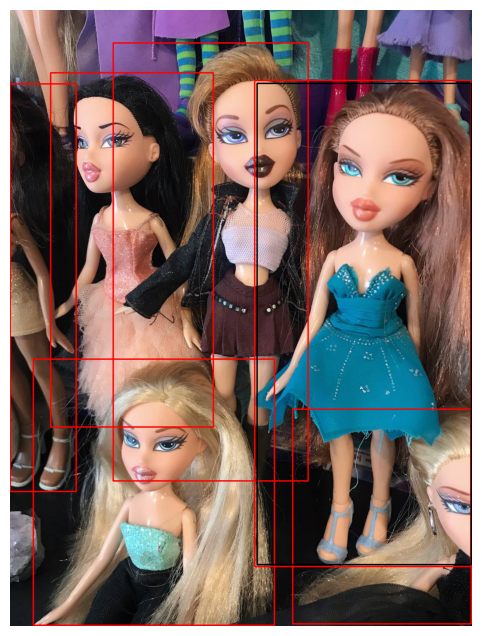

(0.02768754675219543, 48636, 1756602)
(-0.004005488902870284, -5908, 1474976)
(0.20105164176712922, 286080, 1422918)
(0.22040074198258838, 419900, 1905166)
(0.9817883110873565, 1094800, 1115108)
(-0.23258460883722543, -376000, 1616616)
2023-04-19 23.16.34.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  48  725  549 1278]
predicted_box [ 84 130 422 866]
predicted_box [214  68 619 978]
predicted_box [ 587  829  958 1275]
predicted_box [ 508  146  957 1156]
predicted_box [   0  153  137 1000]
predicted_box (513, 152, 958, 1152)


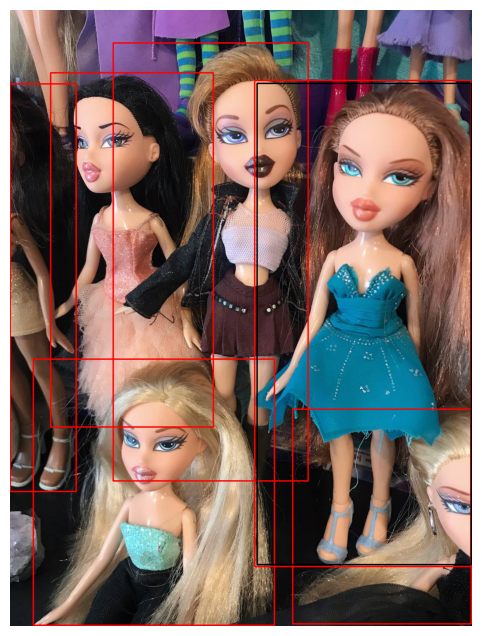

(0.02768754675219543, 48636, 1756602)
(-0.004005488902870284, -5908, 1474976)
(0.20105164176712922, 286080, 1422918)
(0.22040074198258838, 419900, 1905166)
(0.9817883110873565, 1094800, 1115108)
(-0.23258460883722543, -376000, 1616616)
2023-04-19 23.16.34.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  48  725  549 1278]
predicted_box [ 84 130 422 866]
predicted_box [214  68 619 978]
predicted_box [ 587  829  958 1275]
predicted_box [ 508  146  957 1156]
predicted_box [   0  153  137 1000]
predicted_box (513, 152, 958, 1152)


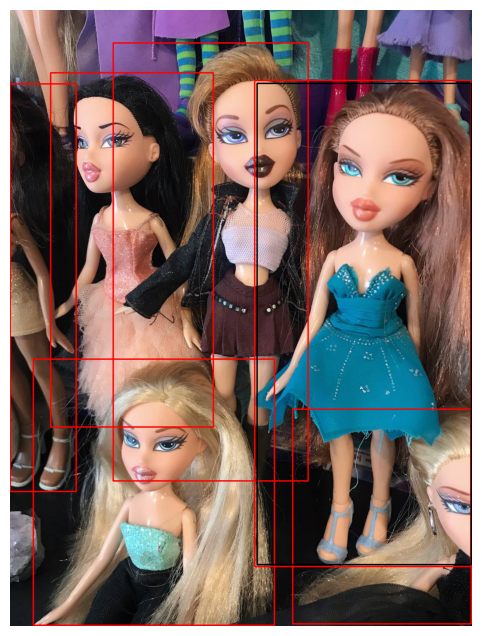

(0.02768754675219543, 48636, 1756602)
(-0.004005488902870284, -5908, 1474976)
(0.20105164176712922, 286080, 1422918)
(0.22040074198258838, 419900, 1905166)
(0.9817883110873565, 1094800, 1115108)
(-0.23258460883722543, -376000, 1616616)
2023-04-19 23.16.34.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  48  725  549 1278]
predicted_box [ 84 130 422 866]
predicted_box [214  68 619 978]
predicted_box [ 587  829  958 1275]
predicted_box [ 508  146  957 1156]
predicted_box [   0  153  137 1000]
predicted_box (513, 152, 958, 1152)


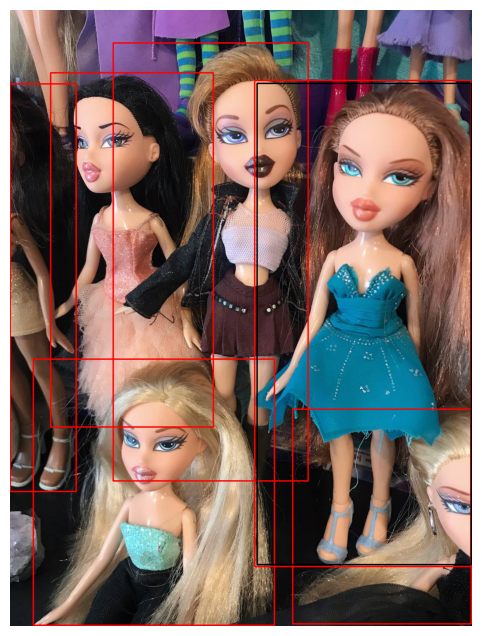

(0.02768754675219543, 48636, 1756602)
(-0.004005488902870284, -5908, 1474976)
(0.20105164176712922, 286080, 1422918)
(0.22040074198258838, 419900, 1905166)
(0.9817883110873565, 1094800, 1115108)
(-0.23258460883722543, -376000, 1616616)
2023-04-19 23.16.38.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 66  76 501 949]
predicted_box [ 516  638  955 1171]
predicted_box [466 360 804 844]
predicted_box (68, 80, 502, 949)


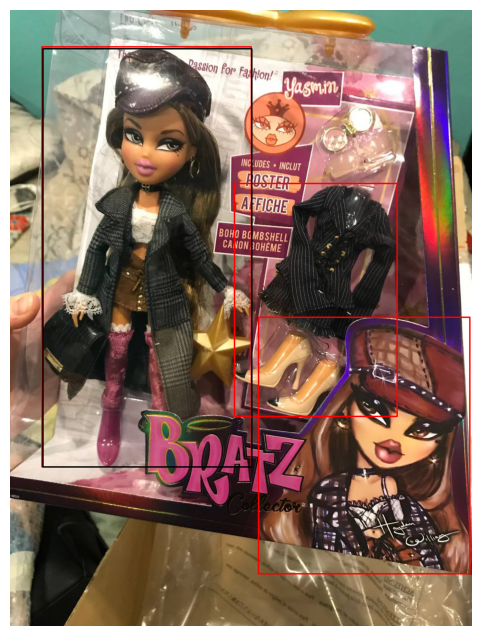

(0.9818089828687548, 471555, 480292)
(0.013417734872320536, 21114, 1573589)
(0.06410183177046576, 69576, 1085398)
2023-04-19 23.16.40.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 221   14  734 1249]
predicted_box (227, 17, 731, 1249)


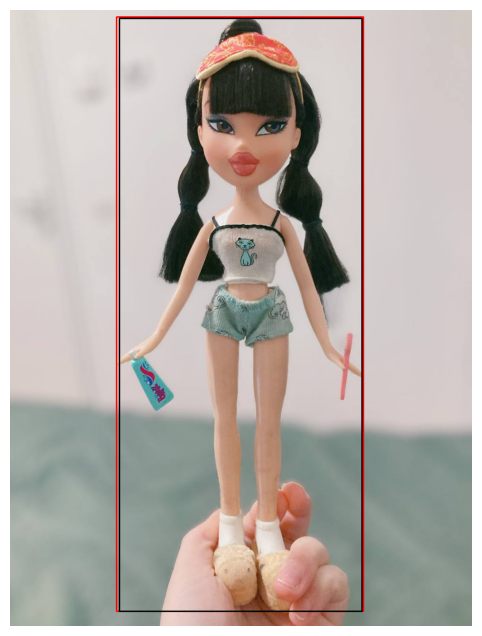

(0.9830832873630239, 907088, 922697)
2023-04-19 23.16.42.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 71  66 544 811]
predicted_box (84, 70, 484, 836)


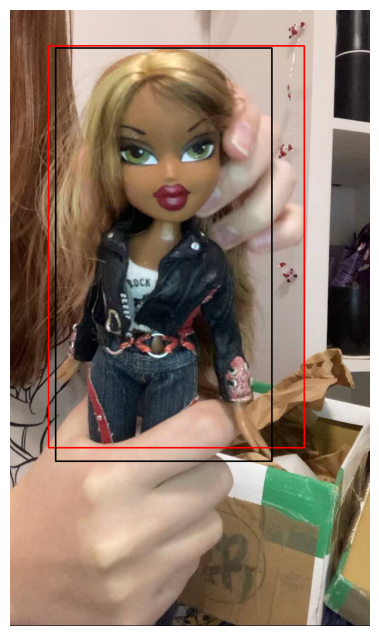

(0.8580202978779491, 390588, 455220)
2023-04-19 23.16.44.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  18   98  388 1220]
predicted_box [ 292   75  603 1220]
predicted_box [ 553   98  852 1233]
predicted_box [ 753   75 1107 1232]
predicted_box [1029  151 1173 1234]
predicted_box (5, 103, 396, 1219)


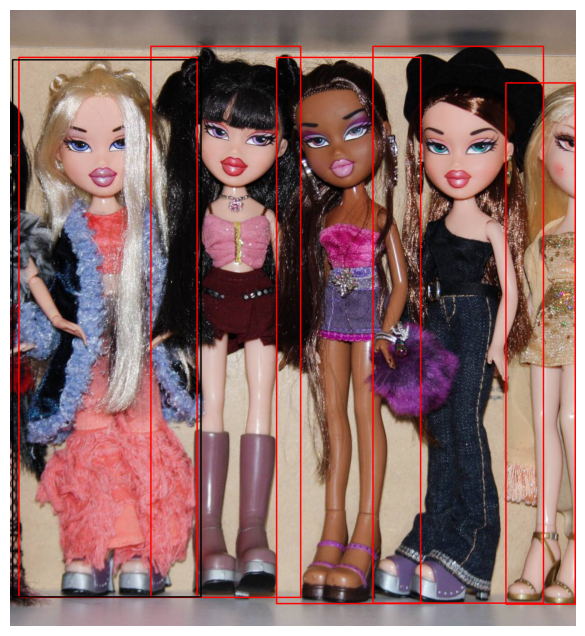

(0.9482535522956195, 465345, 490739)
(0.11936908795578324, 129928, 1088456)
(-0.10781785341873976, -185288, 1718528)
(-0.18667028430783542, -423808, 2270356)
(-0.275881473322644, -735388, 2665594)
2023-04-19 23.16.44.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  18   98  388 1220]
predicted_box [ 292   75  603 1220]
predicted_box [ 553   98  852 1233]
predicted_box [ 753   75 1107 1232]
predicted_box [1029  151 1173 1234]
predicted_box (5, 103, 396, 1219)


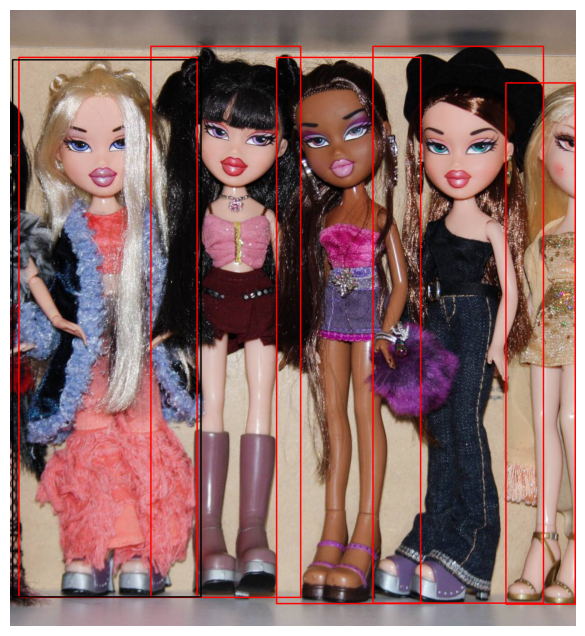

(0.9482535522956195, 465345, 490739)
(0.11936908795578324, 129928, 1088456)
(-0.10781785341873976, -185288, 1718528)
(-0.18667028430783542, -423808, 2270356)
(-0.275881473322644, -735388, 2665594)
2023-04-19 23.16.44.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  18   98  388 1220]
predicted_box [ 292   75  603 1220]
predicted_box [ 553   98  852 1233]
predicted_box [ 753   75 1107 1232]
predicted_box [1029  151 1173 1234]
predicted_box (5, 103, 396, 1219)


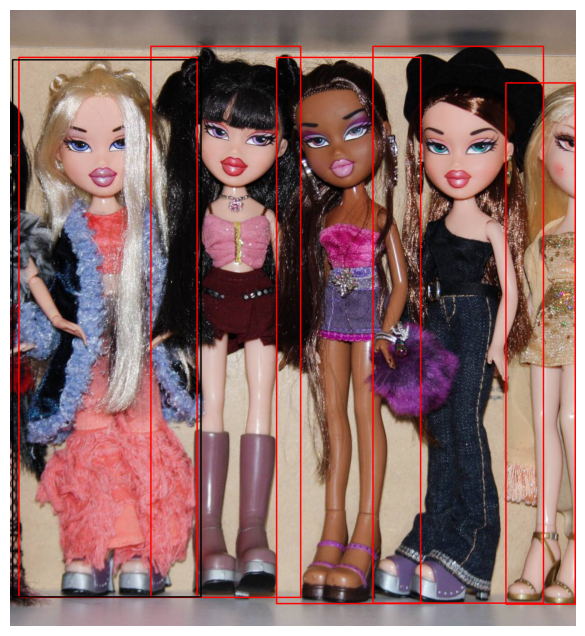

(0.9482535522956195, 465345, 490739)
(0.11936908795578324, 129928, 1088456)
(-0.10781785341873976, -185288, 1718528)
(-0.18667028430783542, -423808, 2270356)
(-0.275881473322644, -735388, 2665594)
2023-04-19 23.16.44.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  18   98  388 1220]
predicted_box [ 292   75  603 1220]
predicted_box [ 553   98  852 1233]
predicted_box [ 753   75 1107 1232]
predicted_box [1029  151 1173 1234]
predicted_box (5, 103, 396, 1219)


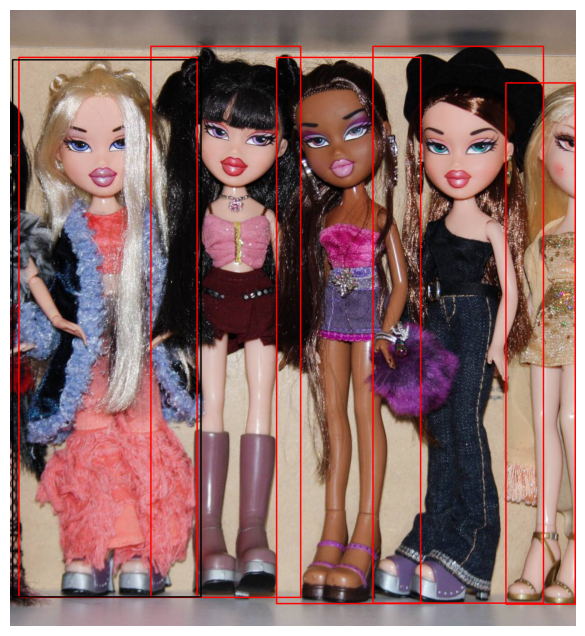

(0.9482535522956195, 465345, 490739)
(0.11936908795578324, 129928, 1088456)
(-0.10781785341873976, -185288, 1718528)
(-0.18667028430783542, -423808, 2270356)
(-0.275881473322644, -735388, 2665594)
2023-04-19 23.16.44.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [  18   98  388 1220]
predicted_box [ 292   75  603 1220]
predicted_box [ 553   98  852 1233]
predicted_box [ 753   75 1107 1232]
predicted_box [1029  151 1173 1234]
predicted_box (5, 103, 396, 1219)


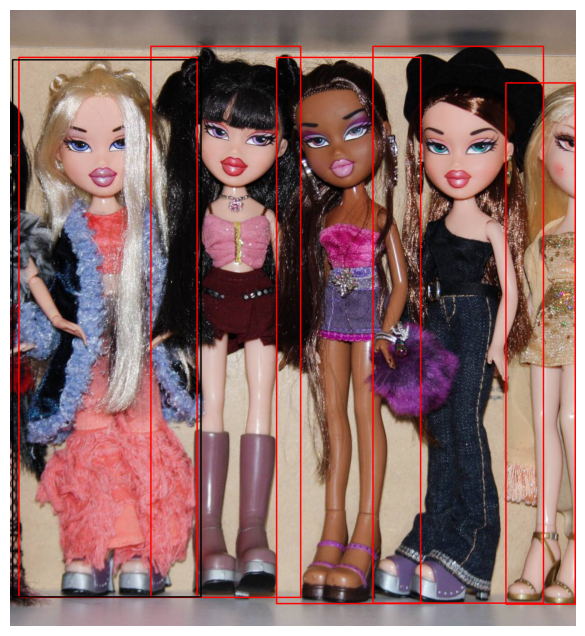

(0.9482535522956195, 465345, 490739)
(0.11936908795578324, 129928, 1088456)
(-0.10781785341873976, -185288, 1718528)
(-0.18667028430783542, -423808, 2270356)
(-0.275881473322644, -735388, 2665594)
2023-04-19 23.16.55.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [353 245 609 908]
predicted_box [ 669  787  790 1093]
predicted_box [ 765  765  887 1097]
predicted_box (362, 247, 604, 908)


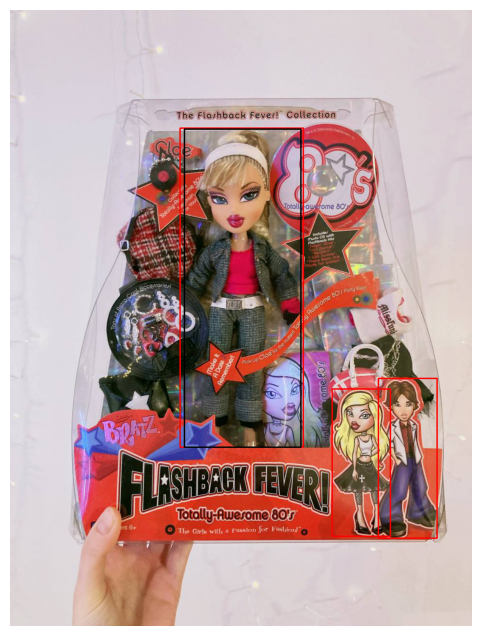

(0.9745358584735857, 543600, 557804)
(0.08390564760180745, 109296, 1302606)
(0.05432127510513963, 78390, 1443081)
2023-04-19 23.16.59.jpg


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


predicted_box [ 193   64  706 1181]
predicted_box (197, 71, 700, 1181)


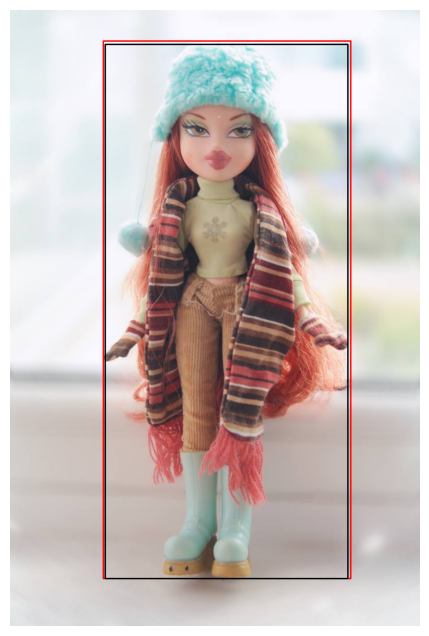

(0.9798661239128827, 821800, 838686)


In [67]:
TEXT_PROMPT = "doll"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

for fname in annot_df['file_name']:
    print(fname)
    IMAGE_PATH = os.path.join(HOME, 'data', fname)

    image_source, image = load_image(IMAGE_PATH)

    # ‘cxcywh’ : boxes are represented via centre, width and height, cx, cy being center of box, w, h being width and height.
    predicted_boxes, logits, phrases = predict(
        model=model,
        image=image,
        caption=TEXT_PROMPT,
        box_threshold=BOX_TRESHOLD,
        text_threshold=TEXT_TRESHOLD
    )

    predicted_boxes_xyxy_list = convert_pred_boxes_to_xyxy(predicted_boxes=predicted_boxes, image_source=image_source)

    img = plot_bb(bb_xyxy_list=predicted_boxes_xyxy_list, img=image_source, color=(255, 0, 0), plot=False)

    gt_bbox_list = [annot_df[annot_df['file_name'] == fname].apply(lambda x: x['pt1'] + x['pt2'], axis=1).values[0]]
    plot_bb(bb_xyxy_list=gt_bbox_list, img=img, color=(0, 0, 0));

    for predicted_box in predicted_boxes_xyxy_list:
        res = intersection_over_union(
            gt_box=gt_bbox_list[0],
            pred_box=predicted_box)
        print(res)

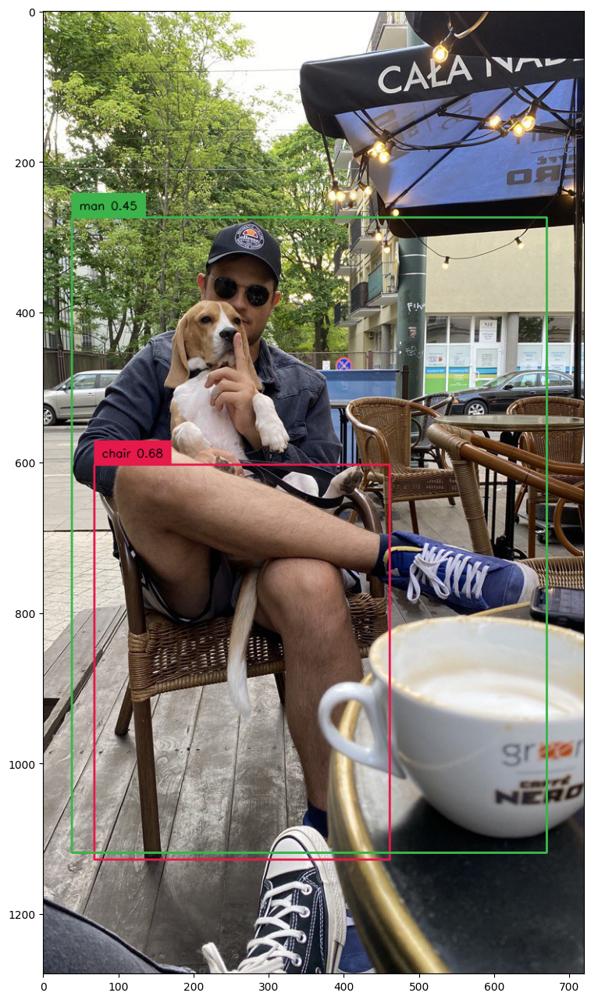

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-3.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "chair with man sitting on it"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

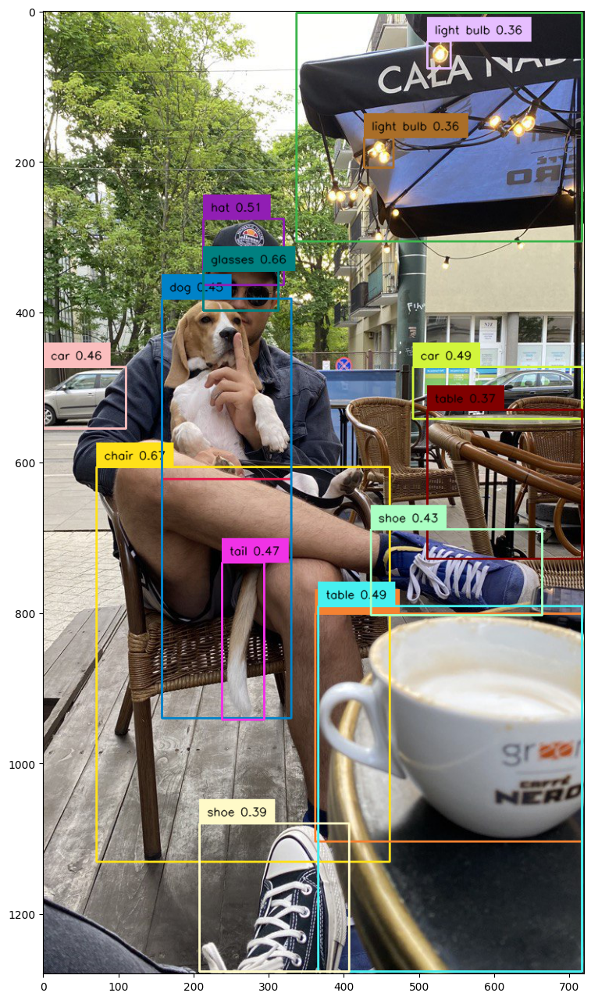

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-3.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "chair, dog, table, shoe, light bulb, coffee, hat, glasses, car, tail, umbrella"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

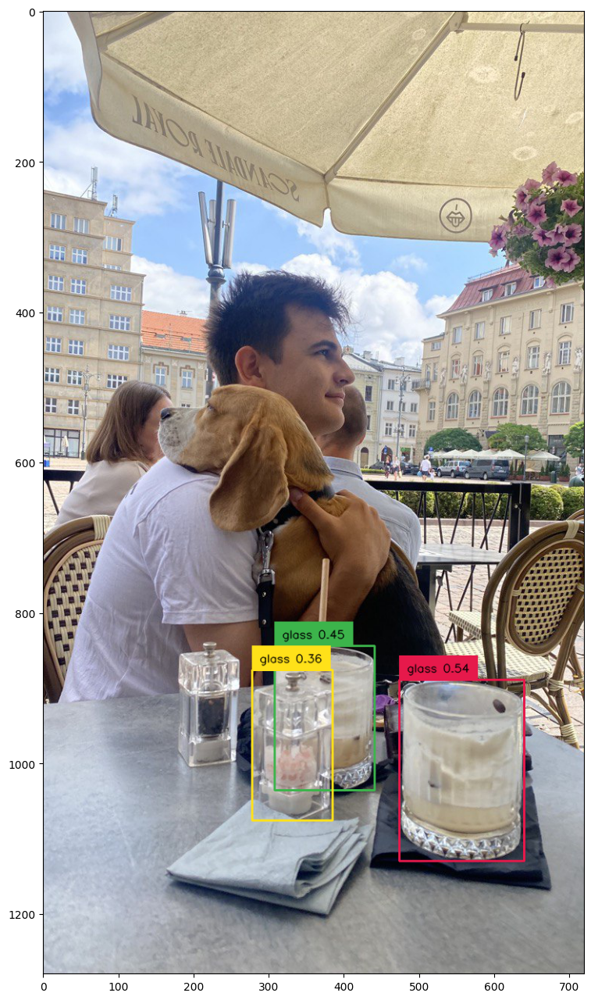

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-2.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "glass"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

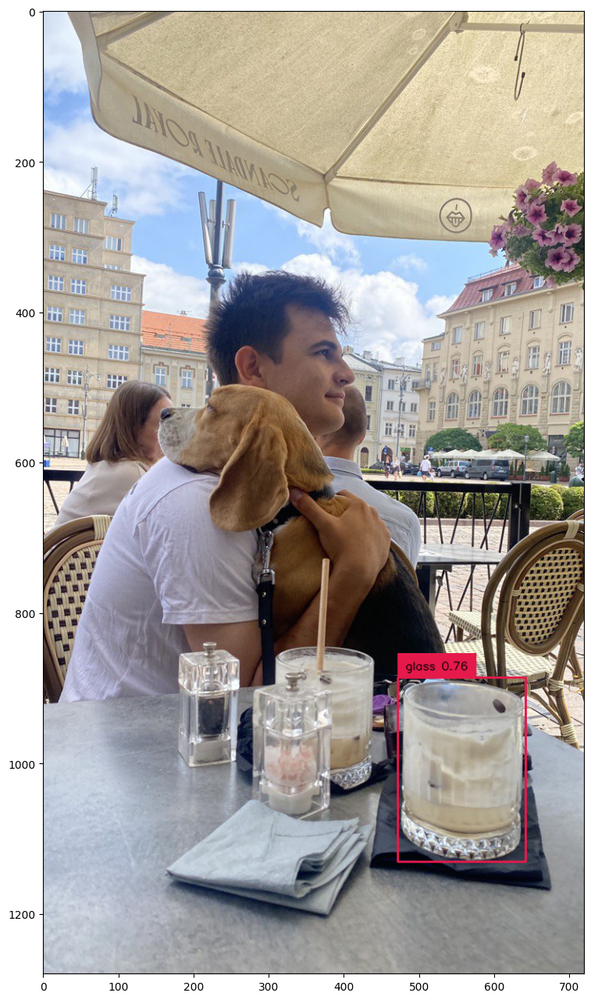

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-2.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "glass most to the right"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

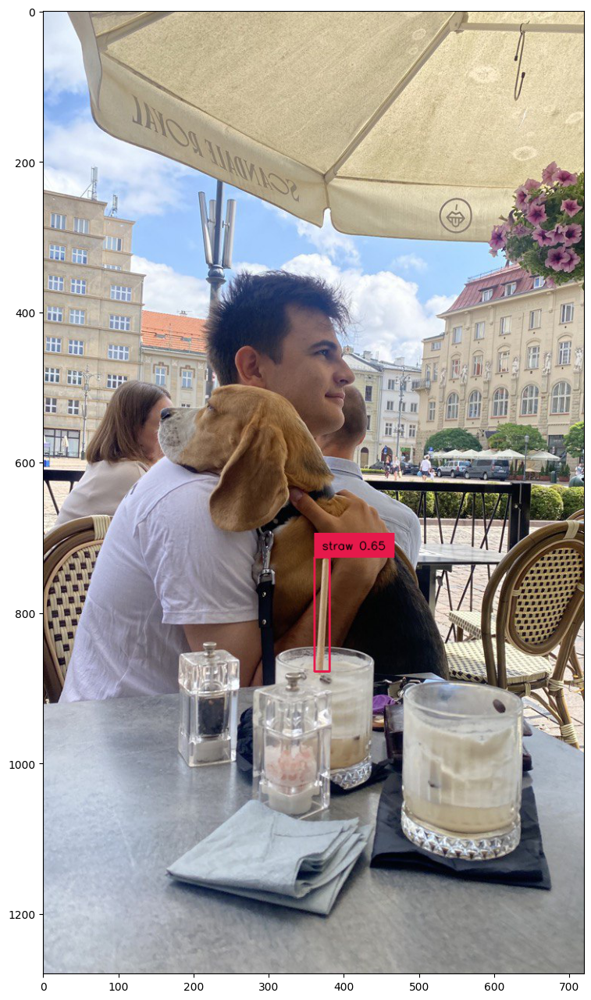

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-2.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "straw"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

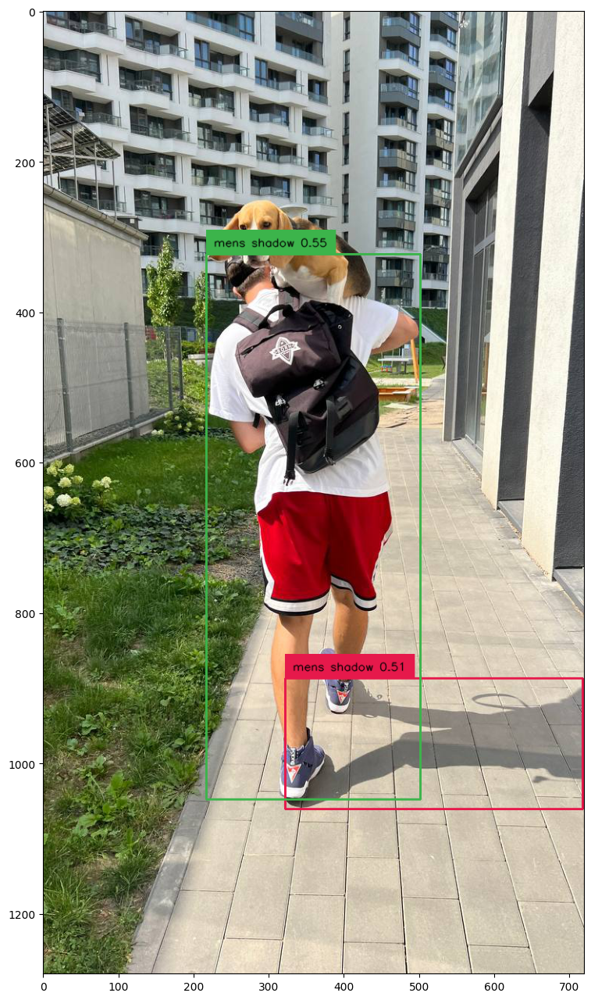

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-4.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "mens shadow"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

## Grounding DINO with Roboflow Dataset

In [ ]:
%cd {HOME}

/content


In [ ]:
import roboflow

roboflow.login()

You are already logged into Roboflow. To make a different login, run roboflow.login(force=True).


In [ ]:
from random import randrange
from roboflow.core.dataset import Dataset


def pick_random_image(dataset: Dataset, subdirrectory: str = "valid") -> str:
    image_directory_path = f"{dataset.location}/{subdirrectory}"
    image_names = os.listdir(image_directory_path)
    image_index = randrange(len(image_names))
    image_name = image_names[image_index]
    image_path = os.path.join(image_directory_path, image_name)
    return image_path

In [ ]:
from roboflow import Roboflow
rf = Roboflow()
project = rf.workspace("work-safe-project").project("safety-vest---v4")
dataset = project.version(3).download("coco")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Safety-vest---v4-3 in coco:: 100%|██████████| 438/438 [00:00<00:00, 836.65it/s]


In [ ]:
TEXT_PROMPT = ", ".join(project.classes.keys())
TEXT_PROMPT

'reflective, not_helmet, helmet, not_reflective'

In [ ]:
image_path = pick_random_image(dataset=dataset)

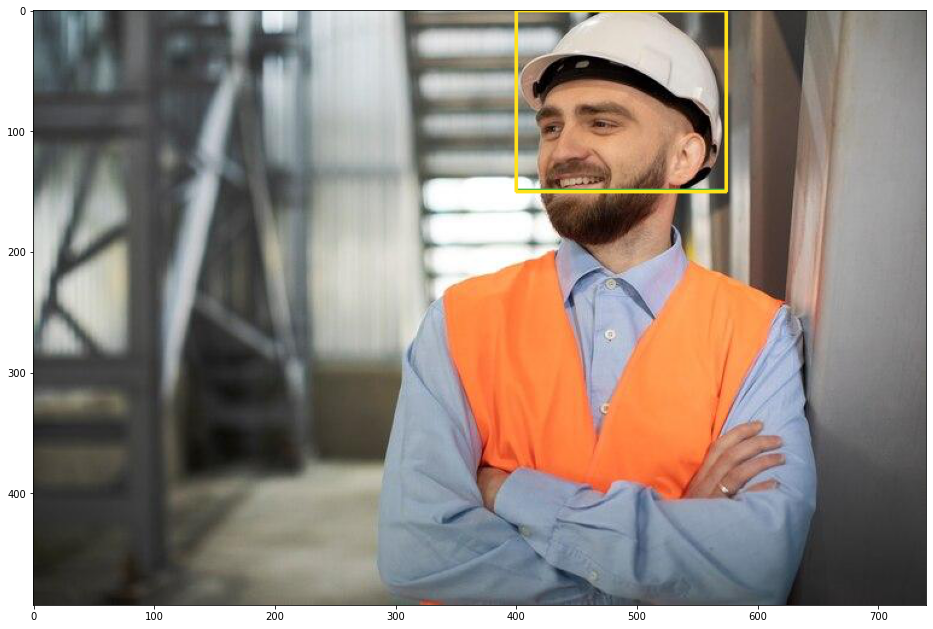

In [ ]:
import os
import supervision as sv

BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(image_path)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

**NOTE:** The design of the prompt is very important. Try to be as accurate as possible. Avoid abbreviations.

In [ ]:
TEXT_PROMPT = "reflective safety vest, helmet, head, nonreflective safety vest"

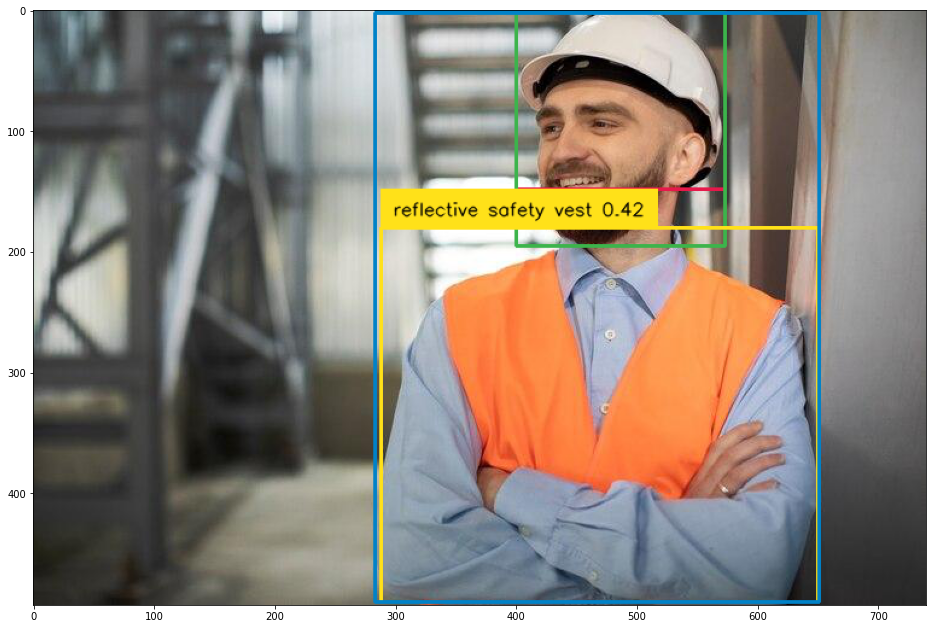

In [ ]:
import os
import supervision as sv

BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(image_path)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

## 🏆 Congratulations

### Learning Resources

Roboflow has produced many resources that you may find interesting as you advance your knowledge of computer vision:

- [Roboflow Notebooks](https://github.com/roboflow/notebooks): A repository of over 20 notebooks that walk through how to train custom models with a range of model types, from YOLOv7 to SegFormer.
- [Roboflow YouTube](https://www.youtube.com/c/Roboflow): Our library of videos featuring deep dives into the latest in computer vision, detailed tutorials that accompany our notebooks, and more.
- [Roboflow Discuss](https://discuss.roboflow.com/): Have a question about how to do something on Roboflow? Ask your question on our discussion forum.
- [Roboflow Models](https://roboflow.com): Learn about state-of-the-art models and their performance. Find links and tutorials to guide your learning.

### Convert data formats

Roboflow provides free utilities to convert data between dozens of popular computer vision formats. Check out [Roboflow Formats](https://roboflow.com/formats) to find tutorials on how to convert data between formats in a few clicks.

### Connect computer vision to your project logic

[Roboflow Templates](https://roboflow.com/templates) is a public gallery of code snippets that you can use to connect computer vision to your project logic. Code snippets range from sending emails after inference to measuring object distance between detections.